In [2]:
!pip install ultralytics
!pip install Opencv
!pip insatll numpy
!pip install collection
from ultralytics import YOLO
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
from collections import OrderedDict, deque
import time


ERROR: Could not find a version that satisfies the requirement Opencv (from versions: none)
ERROR: No matching distribution found for Opencv
ERROR: unknown command "insatll" - maybe you meant "install"
  Preparing metadata (setup.py) ... done
  Created wheel for collection: filename=collection-0.1.6-py3-none-any.whl size=5098 sha256=ecb15b4c8b955f31a0e8434822aa366e1f2678d29fa04663b4bf3d64653de0ac
  Stored in directory: /root/.cache/pip/wheels/12/bb/2e/e430efbb8e7a845a40292527c78c51d201db424b763ae2ccdb
Successfully built collection


In [4]:
class CentroidTracker:
    def __init__(self, max_disappeared=30, max_distance=80):

        # Unique ID counter for new objects
        self.next_object_id = 0

        # Dictionary to store object IDs and their latest centroid positions
        self.objects = OrderedDict()

        # Track how many consecutive frames each object has been missing
        self.disappeared = OrderedDict()

        # Store the movement history (trajectory) of each object
        self.trajectories = OrderedDict()

        self.max_disappeared = max_disappeared
        self.max_distance = max_distance


    def register(self, centroid):
        """
        registers a new object with a new id.
        """
        self.objects[self.next_object_id] = centroid
        self.disappeared[self.next_object_id] = 0
        self.trajectories[self.next_object_id] = deque(maxlen=32)  # Store last 32 centroid positions
        self.trajectories[self.next_object_id].append(centroid)
        self.next_object_id += 1


    def deregister(self, object_id):
        """ removes an object that has disappeared for too long"""
        del self.objects[object_id]
        del self.disappeared[object_id]
        del self.trajectories[object_id]


    def update(self, rects):
        """
        Updates the tracker based on new bounding box detections.

        parameters:
        rects: List of bounding boxes [(x1, y1, x2, y2), ..]

        Return:
        -updated dictionary of tracked object IDs and their centroids.
        """

        # If no detections are present in the current frame
        if len(rects) == 0:
            # Mark existing objects as disappeared
            for object_id in list(self.disappeared.keys()):
                self.disappeared[object_id] += 1
                # Remove objects that disappeared for too many frames
                if self.disappeared[object_id] > self.max_disappeared:
                    self.deregister(object_id)
            return self.objects

        # Compute centroids for all bounding boxes
        input_centroids = np.array([
            (int((x1 + x2) / 2), int((y1 + y2) / 2)) for (x1, y1, x2, y2) in rects
        ])

        # If no objects are currently being tracked, register all centroids as new
        if len(self.objects) == 0:
            for centroid in input_centroids:
                self.register(centroid)
            return self.objects

        # Get current tracked object IDs and their centroids
        object_ids = list(self.objects.keys())
        object_centroids = list(self.objects.values())

        # compute euclidean distance between each pair of old and new centroids
        D = np.linalg.norm(
            np.array(object_centroids)[:, None] - input_centroids[None, :], axis=2
        )

        # find the smallest distance pairings between existing and new centroids
        rows = D.min(axis=1).argsort()
        cols = D.argmin(axis=1)[rows]

        assigned_rows, assigned_cols = set(), set()
# maatch detected centroids to existing tracked objects
        for (row, col) in zip(rows, cols):
            if row in assigned_rows or col in assigned_cols:
                continue
            if D[row, col] > self.max_distance:
                continue

            object_id = object_ids[row]
            self.objects[object_id] = tuple(input_centroids[col])
            self.trajectories[object_id].append(tuple(input_centroids[col]))
            self.disappeared[object_id] = 0

            assigned_rows.add(row)
            assigned_cols.add(col)

        #     mark unmatched old objects as disappeared
        unused_rows = set(range(len(object_centroids))) - assigned_rows
        for row in unused_rows:
            object_id = object_ids[row]
            self.disappeared[object_id] += 1
            if self.disappeared[object_id] > self.max_disappeared:
                self.deregister(object_id)

        #register unmatched new detections as new objects
        unused_cols = set(range(len(input_centroids))) - assigned_cols
        for col in unused_cols:
            self.register(tuple(input_centroids[col]))

        #return the dictionary of active object IDs and centroids
        return self.objects



In [ ]:

def count_people_vertical(
        video_path,
        model_path="yolov8n.pt",
        conf_thres=0.35,
        line_position=0.5,
        max_disappeared=30,
        max_distance=80,
        show_every_n=20):

    # initialize YOLO model and centroid tracker
    model = YOLO(model_path)
    tracker = CentroidTracker(max_disappeared=max_disappeared, max_distance=max_distance)

    # open video file
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error opening video")
        return

    # get video properties
    W = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    H = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS) or 20

    # define vertical counting line
    line_x = int(W * line_position)

    # counters for people entering and exiting
    total_in, total_out = 0, 0

    # dictionary to track which side of the line each person is on
    track_sides = {}

    # initialize video writer to save output
    out = cv2.VideoWriter("output_vertical_count.mp4",
                          cv2.VideoWriter_fourcc(*"mp4v"), fps, (W, H))

    frame_no = 0

    # process each frame in the video
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        frame_no += 1

        # rn YOLO detection on current frame (only detect person class = class 0)
        results = model.predict(frame, imgsz=640, conf=conf_thres, classes=[0], verbose=False)
        r = results[0]

        # extract bounding boxes from YOLO results
        boxes = []
        if r.boxes is not None and len(r.boxes) > 0:
            for box in r.boxes:
                xyxy = box.xyxy[0].cpu().numpy()
                x1, y1, x2, y2 = map(int, xyxy)
                boxes.append([x1, y1, x2, y2])

        # update tracker with detected boxes
        objects = tracker.update(boxes)
        vis = frame.copy()

        # draw the vertical line (ROI)
        cv2.line(vis, (line_x, 0), (line_x, H), (0, 255, 255), 2)

        # loop over tracked objects
        for oid, centroid in objects.items():
            cX, cY = centroid

            # draw bounding boxes for detected objects
            for (x1, y1, x2, y2) in boxes:
                if x1 < cX < x2 and y1 < cY < y2:
                    cv2.rectangle(vis, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(vis, f"ID {oid}", (x1, y1 - 5),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

            # draw trajectories (movement path)
            pts = tracker.trajectories[oid]
            for i in range(1, len(pts)):
                cv2.line(vis, pts[i-1], pts[i], (255, 0, 0), 2)

            # determine which side of the line the person is on
            prev_side = track_sides.get(oid, None)
            current_side = "left" if cX < line_x else "right"

            # check if a person crossed the line
            if prev_side and prev_side != current_side:
                if prev_side == "left" and current_side == "right":
                    total_in += 1
                elif prev_side == "right" and current_side == "left":
                    total_out += 1

            track_sides[oid] = current_side

        # display current counts
        cv2.putText(vis, f"IN: {total_in}", (30, 40),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        cv2.putText(vis, f"OUT: {total_out}", (30, 80),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

        # save output frame to video
        out.write(vis)

        # periodically display frame (useful in Colab)
        if frame_no % show_every_n == 0:
            cv2_imshow(vis)

    # Clean
    cap.release()
    out.release()
    print(f" Done! Saved as output_vertical_count.mp4 | IN: {total_in}, OUT: {total_out}")



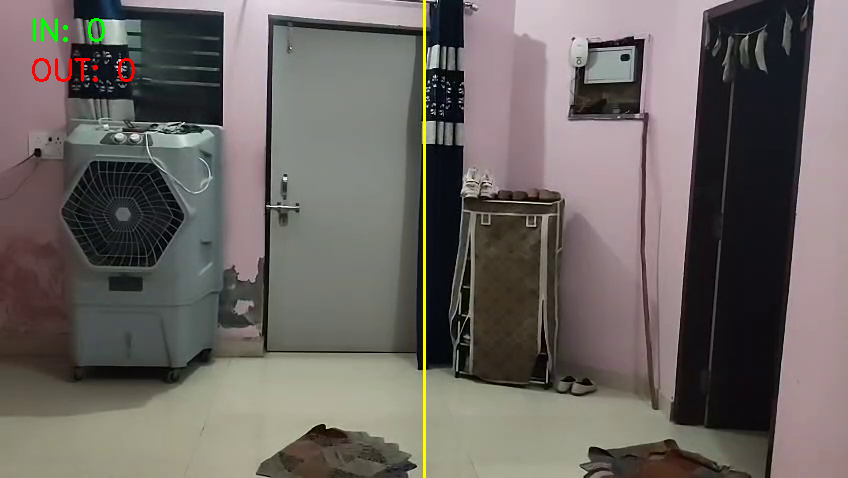

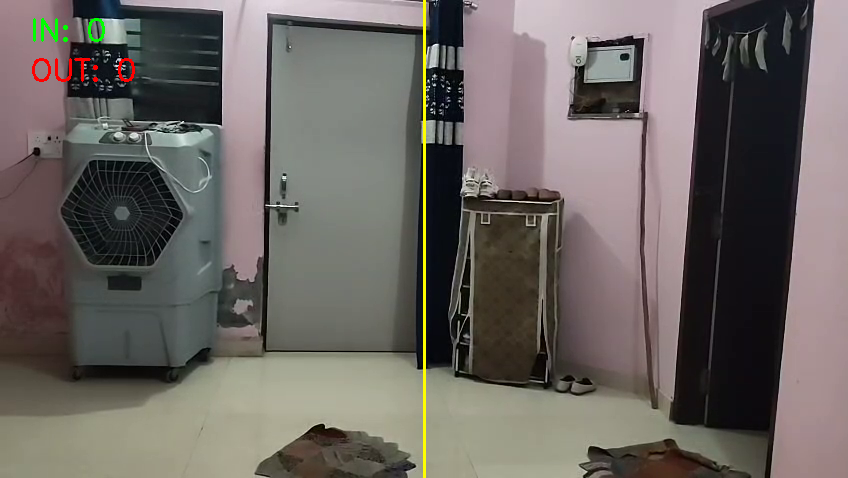

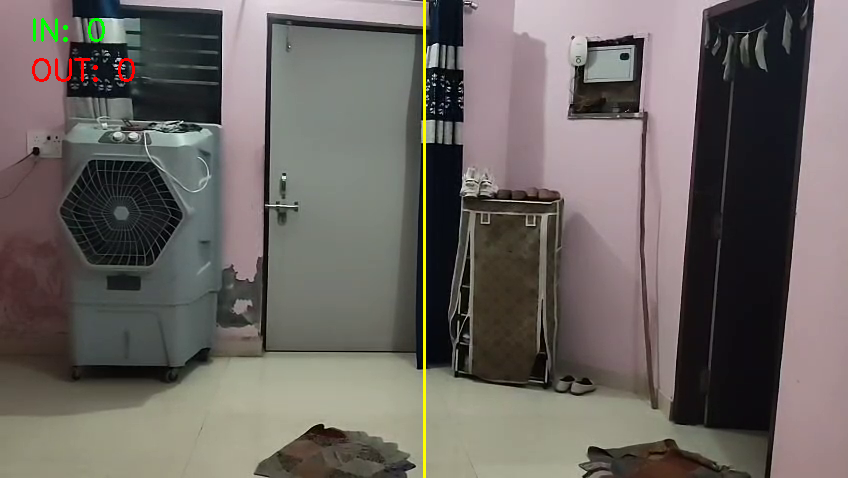

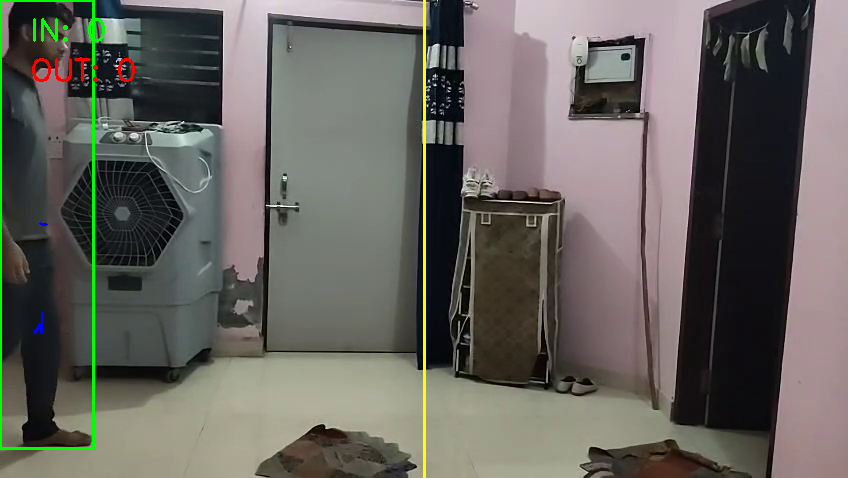

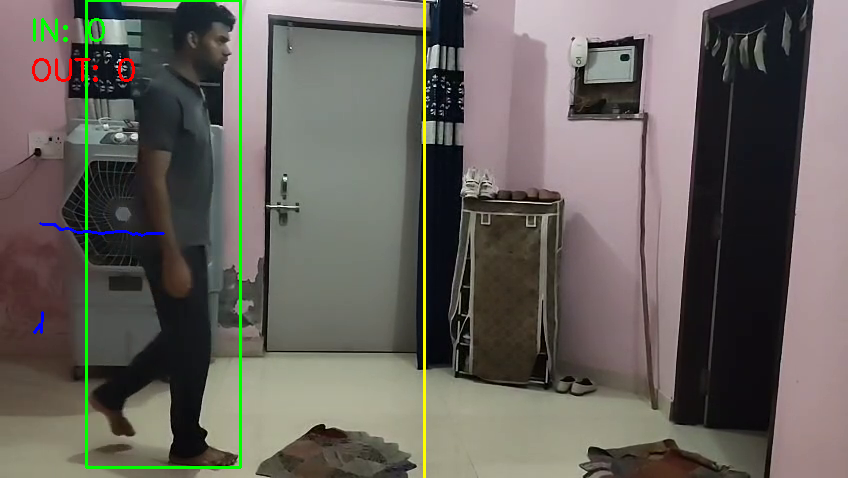

...

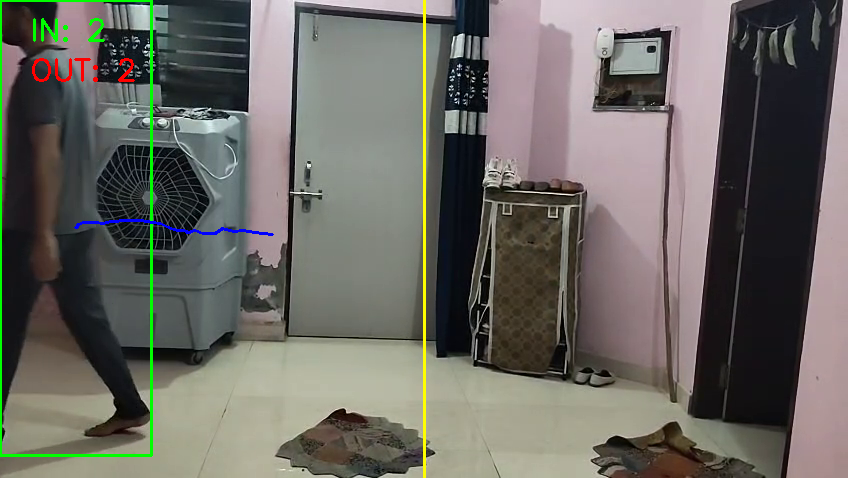

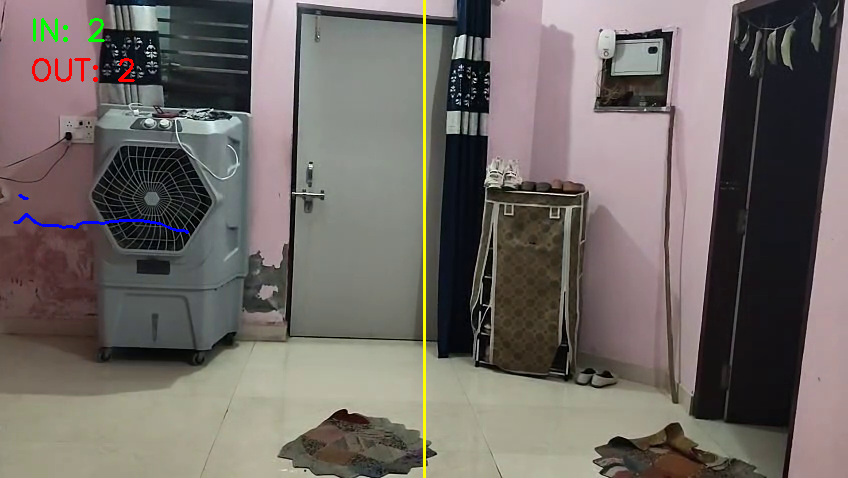

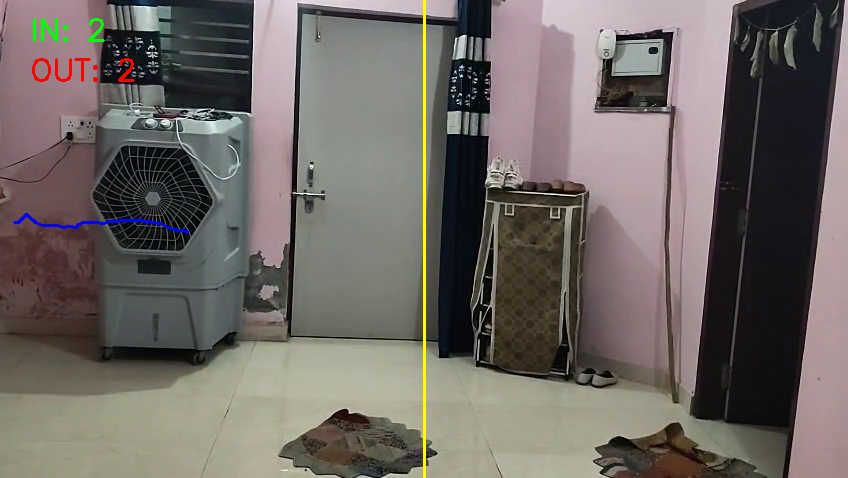

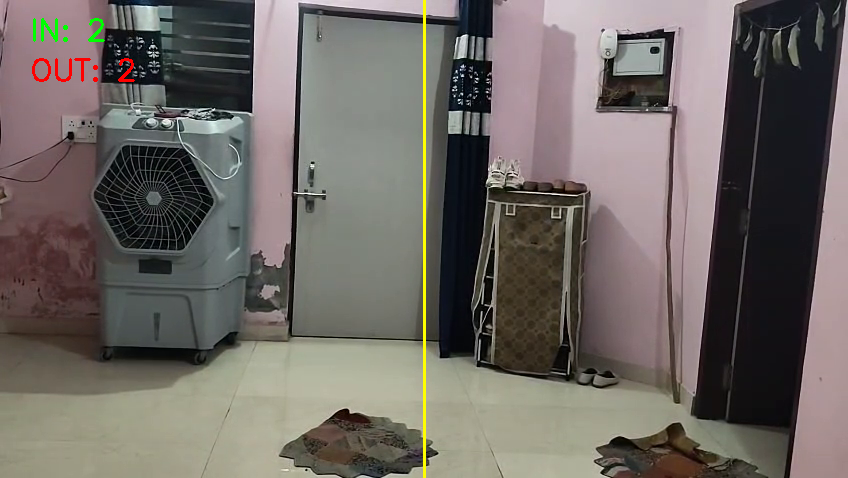

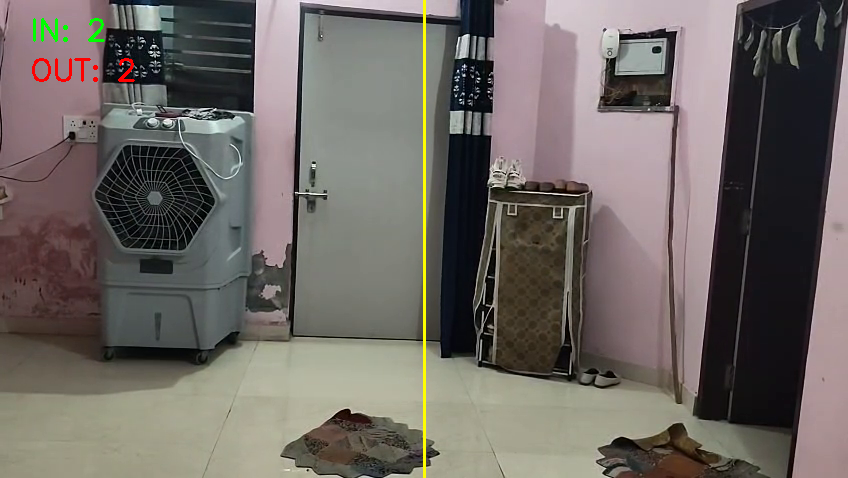

✅ Done! Saved as output_vertical_count.mp4 | IN: 2, OUT: 2


In [ ]:
#  Define video path
video_path = "/content/WhatsApp Video 2025-11-06 at 22.21.04_6138bac4.mp4"  # replace with your actual video path uploaded in the collab runtime

# Run footfall counter
count_people_vertical(video_path)

